## Imports

In [38]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
import seaborn as sns

##  Taking a first glance at data

#### This dataset is from Kaggle that combines all the different datasets from Spotify API

In [39]:
data = pd.read_csv("data\data.csv")
data_w_genre = pd.read_csv('data\data_w_genres.csv')
data_by_genre = pd.read_csv('data\data_by_genres.csv')
data_by_year = pd.read_csv('data\data_by_year.csv')

In [40]:
display(data.head())

,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo,valence,year
0,0.991000,['Mamie Smith'],0.598,168333,0.224,0,0cS0A1fUEUd1EW3FcF8AEI,0.000522,5,0.3790,-12.628,0,Keep A Song In Your Soul,12,1920,0.0936,149.976,0.6340,1920
1,0.643000,"[""Screamin' Jay Hawkins""]",0.852,150200,0.517,0,0hbkKFIJm7Z05H8Zl9w30f,0.026400,5,0.0809,-7.261,0,I Put A Spell On You,7,1920-01-05,0.0534,86.889,0.9500,1920
2,0.993000,['Mamie Smith'],0.647,163827,0.186,0,11m7laMUgmOKqI3oYzuhne,0.000018,0,0.5190,-12.098,1,Golfing Papa,4,1920,0.1740,97.600,0.6890,1920
3,0.000173,['Oscar Velazquez'],0.730,422087,0.798,0,19Lc5SfJJ5O1oaxY0fpwfh,0.801000,2,0.1280,-7.311,1,True House Music - Xavier Santos & Carlos Gomi...,17,1920-01-01,0.0425,127.997,0.0422,1920
4,0.295000,['Mixe'],0.704,165224,0.707,1,2hJjbsLCytGsnAHfdsLejp,0.000246,10,0.4020,-6.036,0,Xuniverxe,2,1920-10-01,0.0768,122.076,0.2990,1920


In [41]:
display(data_by_genre.head())

,genres,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key,mode
0,21st century classical,0.754600,0.284100,3.525932e+05,0.159580,0.484374,0.168580,-22.153400,0.062060,91.351000,0.143380,6.600000,4,1
1,432hz,0.485515,0.312000,1.047430e+06,0.391678,0.477250,0.265940,-18.131267,0.071717,118.900933,0.236483,41.200000,11,1
2,8-bit,0.028900,0.673000,1.334540e+05,0.950000,0.630000,0.069000,-7.899000,0.292000,192.816000,0.997000,0.000000,5,1
3,[],0.535793,0.546937,2.495312e+05,0.485430,0.278442,0.220970,-11.624754,0.101511,116.068980,0.486361,12.350770,7,1
4,a cappella,0.694276,0.516172,2.018391e+05,0.330533,0.036080,0.222983,-12.656547,0.083627,105.506031,0.454077,39.086248,7,1


In [42]:
display(data_by_year.head())

,year,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key,mode
0,1920,0.631242,0.515750,238092.997135,0.418700,0.354219,0.216049,-12.654020,0.082984,113.226900,0.498210,0.610315,2,1
1,1921,0.862105,0.432171,257891.762821,0.241136,0.337158,0.205219,-16.811660,0.078952,102.425397,0.378276,0.391026,2,1
2,1922,0.828934,0.575620,140135.140496,0.226173,0.254776,0.256662,-20.840083,0.464368,100.033149,0.571190,0.090909,5,1
3,1923,0.957247,0.577341,177942.362162,0.262406,0.371733,0.227462,-14.129211,0.093949,114.010730,0.625492,5.205405,0,1
4,1924,0.940200,0.549894,191046.707627,0.344347,0.581701,0.235219,-14.231343,0.092089,120.689572,0.663725,0.661017,10,1


In [43]:
display(data_w_genre.head())

,artists,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key,mode,count,genres
0,"""Cats"" 1981 Original London Cast",0.598500,0.470100,267072.000000,0.376203,0.010261,0.283050,-14.434300,0.209150,114.128800,0.358320,38.200000,5,1,10,['show tunes']
1,"""Cats"" 1983 Broadway Cast",0.862538,0.441731,287280.000000,0.406808,0.081158,0.315215,-10.690000,0.176212,103.044154,0.268865,31.538462,5,1,26,[]
2,"""Fiddler On The Roof” Motion Picture Chorus",0.856571,0.348286,328920.000000,0.286571,0.024593,0.325786,-15.230714,0.118514,77.375857,0.354857,34.571429,0,1,7,[]
3,"""Fiddler On The Roof” Motion Picture Orchestra",0.884926,0.425074,262890.962963,0.245770,0.073587,0.275481,-15.639370,0.123200,88.667630,0.372030,34.407407,0,1,27,[]
4,"""Joseph And The Amazing Technicolor Dreamcoat""...",0.510714,0.467143,270436.142857,0.488286,0.009400,0.195000,-10.236714,0.098543,122.835857,0.482286,42.000000,5,1,7,[]


# Okay so lets take a look at what these headers mean
##### Acousticness: Confidence measure from 0.0 to 1.0 of how acoustic it is
##### danceability: describes how suitable a track is for dancing based on a combination of musical elements including tempo, rhythm stability, beat strength, and overall regularity, measured from 0.0 to 1.0
##### duration_ms: duration of track in milliseconds
##### energy: perceptual measure of intensity and activity. Energetic tracks feel fast, loud and noisy. Death metal has high energy, while a Bach prelude scores low
##### instrumentalness: Predicts whether a track contains no vocals. “Ooh” and “aah” sounds are treated as instrumental in this context. Rap or spoken word tracks are clearly “vocal”. The closer the instrumentalness value is to 1.0, the greater likelihood the track contains no vocal content. Values above 0.5 are intended to represent instrumental tracks, but confidence is higher as the value approaches 1.0.
##### Key: The key the track is in. Integers map to pitches using standard Pitch Class notation . E.g. 0 = C, 1 = C♯/D♭, 2 = D, and so on.
##### liveness: Detects the presence of an audience in the recording. Higher liveness values represent an increased probability that the track was performed live. A value above 0.8 provides strong likelihood that the track is live.
##### loudness: loudness The overall loudness of a track in decibels (dB). Loudness values are averaged across the entire track and are useful for comparing relative loudness of tracks. Loudness is the quality of a sound that is the primary psychological correlate of physical strength (amplitude). Values typical range between -60 and 0 db.
##### mode: Mode indicates the modality (major or minor) of a track, the type of scale from which its melodic content is derived. Major is represented by 1 and minor is 0.
##### speechiness: Speechiness detects the presence of spoken words in a track. The more exclusively speech-like the recording (e.g. talk show, audio book, poetry), the closer to 1.0 the attribute value. Values above 0.66 describe tracks that are probably made entirely of spoken words. Values between 0.33 and 0.66 describe tracks that may contain both music and speech, either in sections or layered, including such cases as rap music. Values below 0.33 most likely represent music and other non-speech-like tracks.
##### tempo: The overall estimated tempo of a track in beats per minute (BPM). In musical terminology, tempo is the speed or pace of a given piece and derives directly from the average beat duration.
##### time_signature: An estimated overall time signature of a track. The time signature (meter) is a notational convention to specify how many beats are in each bar (or measure).
##### valence: A measure from 0.0 to 1.0 describing the musical positiveness conveyed by a track. Tracks with high valence sound more positive (e.g. happy, cheerful, euphoric), while tracks with low valence sound more negative (e.g. sad, depressed, angry).

In [44]:
display(data.describe())

,acousticness,danceability,duration_ms,energy,explicit,instrumentalness,key,liveness,loudness,mode,popularity,speechiness,tempo,valence,year
count,174389.000000,174389.000000,1.743890e+05,174389.000000,174389.000000,174389.000000,174389.000000,174389.000000,174389.000000,174389.000000,174389.000000,174389.000000,174389.000000,174389.000000,174389.000000
mean,0.499228,0.536758,2.328100e+05,0.482721,0.068135,0.197252,5.205305,0.211123,-11.750865,0.702384,25.693381,0.105729,117.006500,0.524533,1977.061764
std,0.379936,0.176025,1.483958e+05,0.272685,0.251978,0.334574,3.518292,0.180493,5.691591,0.457211,21.872740,0.182260,30.254178,0.264477,26.907950
min,0.000000,0.000000,4.937000e+03,0.000000,0.000000,0.000000,0.000000,0.000000,-60.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1920.000000
25%,0.087700,0.414000,1.661330e+05,0.249000,0.000000,0.000000,2.000000,0.099200,-14.908000,0.000000,1.000000,0.035200,93.931000,0.311000,1955.000000
50%,0.517000,0.548000,2.057870e+05,0.465000,0.000000,0.000524,5.000000,0.138000,-10.836000,1.000000,25.000000,0.045500,115.816000,0.536000,1977.000000
75%,0.895000,0.669000,2.657200e+05,0.711000,0.000000,0.252000,8.000000,0.270000,-7.499000,1.000000,42.000000,0.076300,135.011000,0.743000,1999.000000
max,0.996000,0.988000,5.338302e+06,1.000000,1.000000,1.000000,11.000000,1.000000,3.855000,1.000000,100.000000,0.971000,243.507000,1.000000,2021.000000


In [45]:
display(data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 174389 entries, 0 to 174388
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   acousticness      174389 non-null  float64
 1   artists           174389 non-null  object 
 2   danceability      174389 non-null  float64
 3   duration_ms       174389 non-null  int64  
 4   energy            174389 non-null  float64
 5   explicit          174389 non-null  int64  
 6   id                174389 non-null  object 
 7   instrumentalness  174389 non-null  float64
 8   key               174389 non-null  int64  
 9   liveness          174389 non-null  float64
 10  loudness          174389 non-null  float64
 11  mode              174389 non-null  int64  
 12  name              174389 non-null  object 
 13  popularity        174389 non-null  int64  
 14  release_date      174389 non-null  object 
 15  speechiness       174389 non-null  float64
 16  tempo             17

None

In [46]:
# Based on the details of the headers labelled above, it seems like there is no missing data, and that all the data fit within the constraints

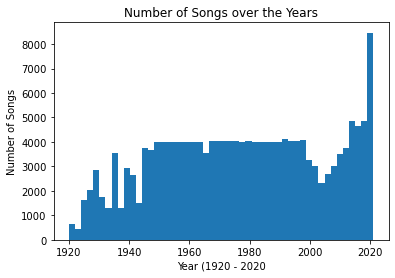

In [47]:
# first thing I want to do is see how the number of tracks have changed throughout the year!
plt.hist(data['year'], bins = 50)
plt.title('Number of Songs over the Years')
plt.xlabel('Year (1920 - 2020')
plt.ylabel('Number of Songs')
plt.show()


In [48]:
# it seems like there is not much data before 1950, which can possibly mess up my data, so I will remove
data_2 = data[data['year'] >= 1950]
data_by_year_2 = data_by_year[data_by_year['year'] >= 1950]

## Sweet let's start exploring!


### Here are some of the hypotheses I want to test
1. The acousticness has gone down over the years given the rise of more hiphop/techno music
2. New music has been more explicit than old ones. Idk, maybe swearing has gotten more popualar?
3. Overtime, louder and more energetic songs have increased
4. The more popular songs are the ones in major keys
5. The more energy a song has, the more popular it is
6. The more louder the song, the more popular it is
7. Question: Which keys are the most popular?

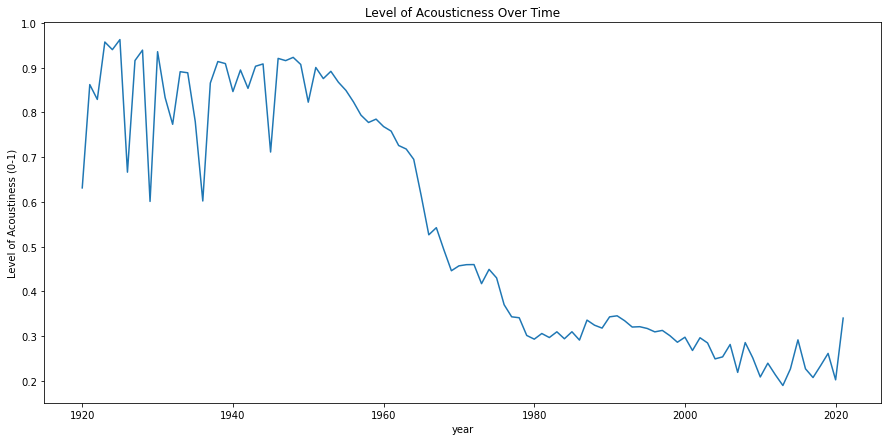

In [49]:
# Hypothesis 1: The acousticness has gone down over the years given the rise of more hiphop/techno music
# Result: Seems like I was correct, theres a huge drop off 

fig, ax = plt.subplots(figsize=(15,7))
plt.title('Level of Acousticness Over Time')
plt.xlabel('Year (1920-2020)')
plt.ylabel('Level of Acoustiness (0-1)')
data.groupby('year')['acousticness'].mean().plot(ax = ax)


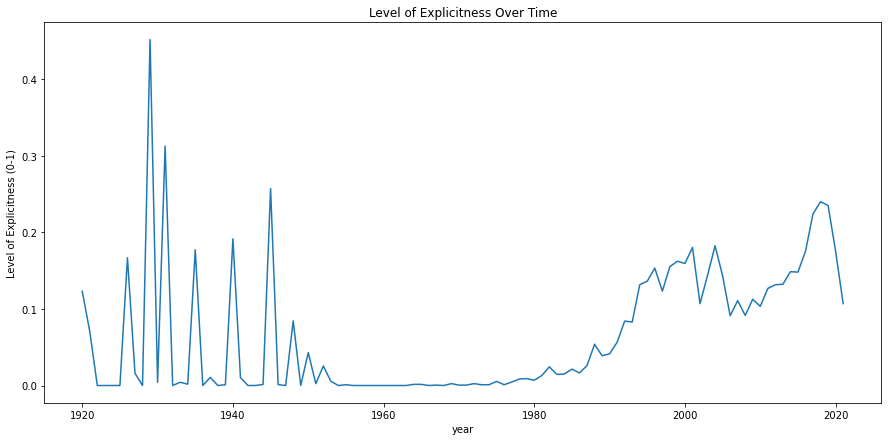

In [50]:
# Hypothesis 2: New music has been more explicit than old ones. Idk, maybe swearing has gotten more popualar?
# Result: This is weirder, I suspect the results before 1950 are not that good, which is why the variability increased by a ton. However from 1960 onwards, we can see that the level of explicitness have gone up
# Because the results prior to 1950 is seemingly bad, I went back up and cleaned it up 
fig, ax = plt.subplots(figsize=(15,7))
plt.title('Level of Explicitness Over Time')
plt.xlabel('Year (1920-2020)')
plt.ylabel('Level of Explicitness (0-1)')
data.groupby('year')['explicit'].mean().plot(ax = ax)

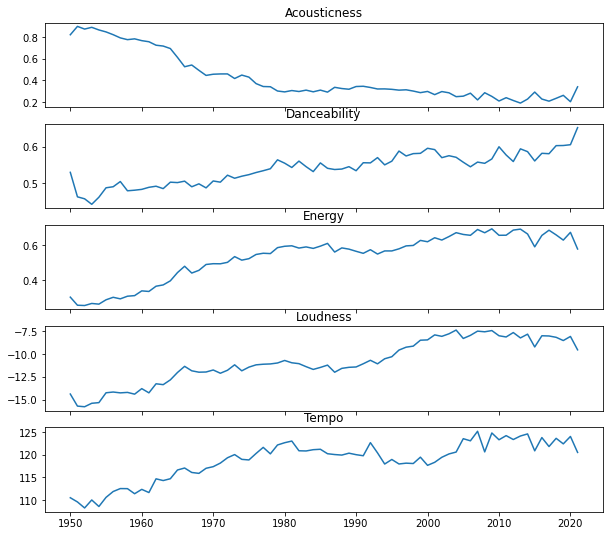

In [51]:
# Hypothesis 3: 3. Overtime, louder and more energetic songs have increased
# Result: I thought I would take this one step further, and plot all the variables I think are related. It seems like more music nowadays are less on acoustics, but more energetic, loud, and have a higher tempo

fig, ax = plt.subplots(5, sharex = True, figsize = (10,9)) 
ax[0].plot('year', 'acousticness', data = data_by_year_2)
ax[0].set_title('Acousticness')
ax[1].plot('year', 'danceability', data = data_by_year_2)
ax[1].set_title('Danceability')
ax[2].plot('year', 'energy', data = data_by_year_2)
ax[2].set_title('Energy')
ax[3].plot('year', 'loudness', data = data_by_year_2)
ax[3].set_title('Loudness')
ax[4].plot('year', 'tempo', data = data_by_year_2)
ax[4].set_title('Tempo')

plt.show()

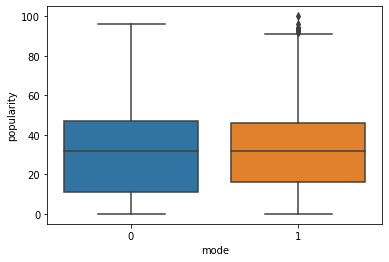

In [52]:
# Hypothesis 4: The more popular songs are the ones in major keys
# Result: seems like major vs minor has no difference in popularity of song 
fig, ax = plt.subplots()
sns.boxplot(data_2['mode'], data_2['popularity'])

plt.show()

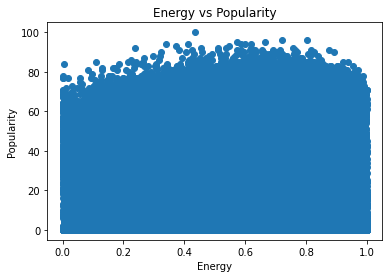

In [53]:
# Hypothesis 5: The more energy a song has, the more popular it is\
# Result: nothing jumps out at me, don't really see a relationship at all
fig, ax = plt.subplots()
ax.scatter('energy', 'popularity', data = data_2)
plt.title('Energy vs Popularity')
plt.xlabel('Energy')
plt.ylabel('Popularity')
plt.show()


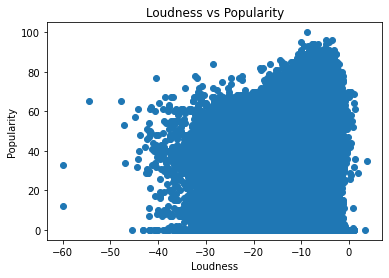

In [54]:
# Hypothesis 6: The more louder the song, the more popular it is
# Result: seems that generally the most popular songs are the louder ones, but then again the relationship isn't that appearant

fig, ax = plt.subplots()
ax.scatter('loudness', 'popularity', data = data_2)
plt.title('Loudness vs Popularity')
plt.xlabel('Loudness')
plt.ylabel('Popularity')
plt.show()


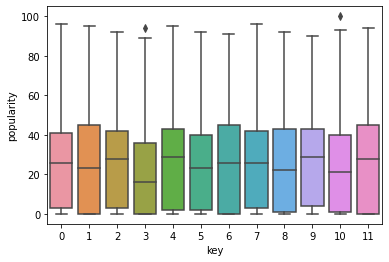

In [56]:
# Hypothesis 7: Question: Which keys are the most popular?

fig, ax = plt.subplots()
sns.boxplot(data['key'], data['popularity'])

plt.show()

In [60]:
# Results: It seems like Key 4 (E), Key 9 (A), Key 2 (D), and Key 11 (B) do quite well
# It seems like Key 3 (Db, E#) does the worst, and black notes do generally worse than white keys 

data.groupby('key')['popularity'].mean().sort_values(ascending = False)

key
4     27.382532
9     27.233917
2     26.746405
11    26.568368
6     26.042380
7     25.906053
0     25.804570
1     25.505899
8     24.930291
5     24.371933
10    23.827583
3     20.958242
Name: popularity, dtype: float64